In [21]:
import matplotlib.pyplot as plt
from torchvision.io import read_image, ImageReadMode
import os

## Load Dataset

In [13]:
# URLs of the files to download
url1 = "https://zenodo.org/records/7358126/files/bdappv.zip?download=1"
url2 = "https://zenodo.org/records/7358126/files/data.zip?download=1"

# Define dataset name
dataset_name = "Kasmi_2023"

# Define the directory to save the files in
save_dir = f"data/{dataset_name}"

# Create the directory if it doesn't exist
os.makedirs(save_dir, exist_ok=True)

# Download the files
os.system(f'wget -O {os.path.join(save_dir, "bdappv.zip")} {url1}')
os.system(f'wget -O {os.path.join(save_dir, "data.zip")} {url2}')

--2024-01-09 11:49:18--  https://zenodo.org/records/7358126/files/bdappv.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.184.103.159, 188.184.98.238, 188.185.79.172
Connecting to zenodo.org (zenodo.org)|188.184.103.159|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8165112873 (7,6G) [application/octet-stream]
Saving to: ‘data/Kemsi_2023/bdappv.zip’

     0K .......... .......... .......... .......... ..........  0%  543K 4h4m
    50K .......... .......... .......... .......... ..........  0% 1,02M 3h5m
   100K .......... .......... .......... .......... ..........  0% 9,80M 2h8m
   150K .......... .......... .......... .......... ..........  0% 9,20M 99m38s
   200K .......... .......... .......... .......... ..........  0% 1,24M 1h40m
   250K .......... .......... .......... .......... ..........  0% 7,65M 86m44s
   300K .......... .......... .......... .......... ..........  0% 17,2M 75m25s
   350K .......... .......... .......... .......... ........

0

In [19]:
!unzip f'data/{dataset_name}/data.zip' -d data/Kasmi_2023
# delete the zip file
!rm data/Kemsi_2023/data.zip
 
!unzip f'data/{dataset_name}/bdappv.zip' -d data/Kasmi_2023
# delete the zip file
!rm fdata/Kasmi_2023/bdappv.zip

Archive:  data/Kemsi_2023/data.zip
   creating: data/Kemsi_2023/data/
   creating: data/Kemsi_2023/data/raw/
  inflating: data/Kemsi_2023/data/raw/input-google.json  
  inflating: data/Kemsi_2023/data/raw/input-ign.json  
  inflating: data/Kemsi_2023/data/raw/raw-metadata.csv  
   creating: data/Kemsi_2023/data/replication/
   creating: data/Kemsi_2023/data/replication/campaign-google/
  inflating: data/Kemsi_2023/data/replication/campaign-google/click-analysis.json  
  inflating: data/Kemsi_2023/data/replication/campaign-google/polygon-analysis.json  
   creating: data/Kemsi_2023/data/replication/campaign-ign/
  inflating: data/Kemsi_2023/data/replication/campaign-ign/click-analysis.json  
  inflating: data/Kemsi_2023/data/replication/campaign-ign/polygon-analysis.json  
   creating: data/Kemsi_2023/data/validation/
   creating: data/Kemsi_2023/data/validation/campaign-google/
  inflating: data/Kemsi_2023/data/validation/campaign-google/click-analysis-thres=1.0.json  
  inflating: dat

Copy the google images to this folder `/data/{dataset_name}/img`.

In [30]:
# Define the source and destination directories
src_dir = f"data/{dataset_name}/bdappv/google/img"
dst_dir = f"data/{dataset_name}/img"

# Create the destination directory if it doesn't exist
os.makedirs(dst_dir, exist_ok=True)

# Get the list of files in the source directory
files = os.listdir(src_dir)

# Copy each file from the source directory to the destination directory
for file in files:
    src_file = os.path.join(src_dir, file)
    dst_file = os.path.join(dst_dir, file)
    os.rename(src_file, dst_file)

Copy the image masks to `data/{dataset_name}/mask`.

In [35]:
# Define the source and destination directories
src_dir = f"data/{dataset_name}/bdappv/google/mask"
dst_dir = f"data/{dataset_name}/mask"

# Create the destination directory if it doesn't exist
os.makedirs(dst_dir, exist_ok=True)

# Get the list of files in the source directory
files = os.listdir(src_dir)

# Copy each file from the source directory to the destination directory
for file in files:
    src_file = os.path.join(src_dir, file)
    dst_file = os.path.join(dst_dir, file)
    os.rename(src_file, dst_file)

In [57]:
img_folder = f"data/{dataset_name}/img"
mask_folder = f"data/{dataset_name}/mask"

img_files = os.listdir(img_folder)
mask_files = os.listdir(mask_folder)

num_img_files = len(img_files)
num_mask_files = len(mask_files)

print(f"Number of files in {img_folder}: {num_img_files}")
print(f"Number of files in {mask_folder}: {num_mask_files}")

Number of files in data/Kasmi_2023/img: 28807
Number of files in data/Kasmi_2023/mask: 13303


We can saee that we have images without solar panels. We transfer images that lack a corresponding mask (indicating absence of solar panels) to the `images_without_mask` directory.

In [60]:
import os
import shutil

# root directory for the dataset
dataset_name = "Kasmi_2023"
root = f"data/{dataset_name}"


# load all image files from the "img" directory inside the root directory
imgs = list(sorted(os.listdir(os.path.join(root, "img"))))
# load all mask files from the "mask" directory inside the root directory
masks = list(sorted(os.listdir(os.path.join(root, "mask"))))

# directory to move images without a mask
img_without_mask_dir = os.path.join("data", dataset_name, "img_without_mask")

# create the directory if it doesn't exist
os.makedirs(img_without_mask_dir, exist_ok=True)

# check if each image has a corresponding mask
for img in imgs:
    # remove the file extension from the image name
    img_name = os.path.splitext(img)[0]
    # check if there is a mask with the same name
    if not any(mask.startswith(img_name) for mask in masks):
        # move the image to the img_without_mask_dir
        shutil.move(
            os.path.join(root, "img", img), os.path.join(img_without_mask_dir, img)
        )

Check if all images have a mask now:

In [61]:
img_folder = f"data/{dataset_name}/img"
mask_folder = f"data/{dataset_name}/mask"

img_files = os.listdir(img_folder)
mask_files = os.listdir(mask_folder)

num_img_files = len(img_files)
num_mask_files = len(mask_files)

print(f"Number of files in {img_folder}: {num_img_files}")
print(f"Number of files in {mask_folder}: {num_mask_files}")

Number of files in data/Kasmi_2023/img: 13303
Number of files in data/Kasmi_2023/mask: 13303


## Writing a Custom Dataset

We use the dataset from Kasmi et. al. 2023 from the nature paper: ['A crowdsources dataset of aerial images with annotated solar photovoltaic arrays and installation metadata'](https://www.nature.com/articles/s41597-023-01951-4)
You can download the data [here](https://zenodo.org/records/7358126). We use the google images and masks.
You can look at their [github repo](https://github.com/gabrielkasmi/bdappv)

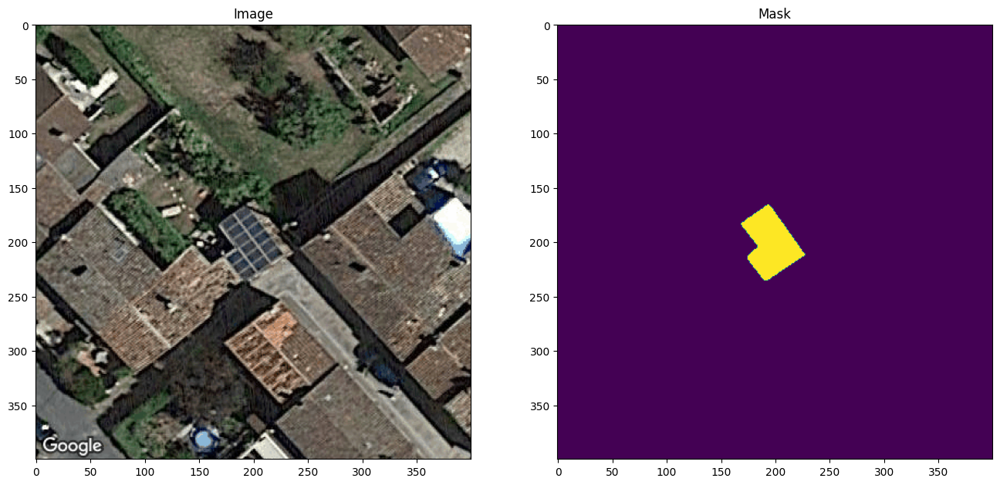

In [37]:
image = read_image(
    f"data/{dataset_name}/img/AABCN78E1YHCWW.png",
    # ImageReadMode is an enumeration in PyTorch's torchvision.io module that specifies the color space and channel format for the image to be read.
    # The available modes are:
    # UNCHANGED: Reads the image as is, including the alpha channel if it exists.
    # GRAY: Converts the image to grayscale.
    # GRAY_ALPHA: Converts the image to grayscale with alpha channel.
    # RGB: Converts the image to RGB.
    # RGB_ALPHA: Converts the image to RGB with alpha channel.
    mode=ImageReadMode.RGB,
)
mask = read_image(f"data/{dataset_name}/mask/AABCN78E1YHCWW.png")

plt.figure(figsize=(16, 8))
plt.subplot(121)
plt.title("Image")
plt.imshow(image.permute(1, 2, 0))
plt.subplot(122)
plt.title("Mask")
plt.imshow(mask.permute(1, 2, 0))

So each image has a corresponding segmentation mask, where each color correspond to a different instance. Let’s write a [torch.utils.data.Dataset](https://pytorch.org/docs/stable/data.html#torch.utils.data.Dataset) class for this dataset. In the code below, we are wrapping images, bounding boxes and masks into [torchvision.tv_tensors.TVTensor](https://pytorch.org/vision/stable/generated/torchvision.tv_tensors.TVTensor.html#torchvision.tv_tensors.TVTensor) classes so that we will be able to apply torchvision built-in transformations ([new Transforms API](https://pytorch.org/vision/stable/transforms.html)) for the given object detection and segmentation task. Namely, image tensors will be wrapped by [torchvision.tv_tensors.Image](https://pytorch.org/vision/stable/generated/torchvision.tv_tensors.Image.html#torchvision.tv_tensors.Image), bounding boxes into [torchvision.tv_tensors.BoundingBoxes](https://pytorch.org/vision/stable/generated/torchvision.tv_tensors.BoundingBoxes.html#torchvision.tv_tensors.BoundingBoxes) and masks into [torchvision.tv_tensors.Mask](https://pytorch.org/vision/stable/generated/torchvision.tv_tensors.Mask.html#torchvision.tv_tensors.Mask). As [torchvision.tv_tensors.TVTensor](https://pytorch.org/vision/stable/generated/torchvision.tv_tensors.TVTensor.html#torchvision.tv_tensors.TVTensor) are [torch.Tensor](https://pytorch.org/docs/stable/tensors.html#torch.Tensor) subclasses, wrapped objects are also tensors and inherit the plain torch.Tensor API. For more information about torchvision tv_tensors see [this documentation](https://pytorch.org/vision/main/auto_examples/transforms/plot_transforms_getting_started.html#what-are-tvtensors).

We need to save this dataset class to a new file called `dataset.py`: 

```python
import os
import torch

from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision import tv_tensors
from torchvision.transforms.v2 import functional as F
from torch.utils.data import Dataset



class SolarPanelDataset(Dataset):
    def __init__(self, root, transforms):
        # root directory for the dataset
        self.root = root
        # transformations to be applied on the images and masks
        self.transforms = transforms

        # os.path.join is used to combine parts of a path in a platform-independent way
        # os.listdir returns a list of all files in the specified directory
        # sorted() is used to sort the list of files, ensuring that the images and masks align

        # load all image files from the "images" directory inside the root directory
        self.imgs = list(sorted(os.listdir(os.path.join(root, "img"))))
        # load all mask files from the "masks" directory inside the root directory
        self.masks = list(sorted(os.listdir(os.path.join(root, "mask"))))

    def __getitem__(self, idx):
        # load images and masks
        img_path = os.path.join(self.root, "img", self.imgs[idx])
        mask_path = os.path.join(self.root, "mask", self.masks[idx])
        img = read_image(img_path)
        mask = read_image(mask_path)
        # instances are encoded as different colors
        obj_ids = torch.unique(mask)
        # first id is the background, so remove it
        obj_ids = obj_ids[1:]
        num_objs = len(obj_ids)

        # split the color-encoded mask into a set
        # of binary masks
        masks = (mask == obj_ids[:, None, None]).to(dtype=torch.uint8)

        # get bounding box coordinates for each mask
        boxes = masks_to_boxes(masks)

        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)

        image_id = idx
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Wrap sample and targets into torchvision tv_tensors:
        img = tv_tensors.Image(img)

        target = {}
        target["boxes"] = tv_tensors.BoundingBoxes(
            boxes, format="XYXY", canvas_size=F.get_size(img)
        )
        target["masks"] = tv_tensors.Mask(masks)
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)
```

That’s all for the dataset. Now let’s define a model that can perform predictions on this dataset.

## Defining our Model

In this tutorial, we will be using [Mask R-CNN](https://arxiv.org/abs/1703.06870), which is based on top of [Faster R-CNN](https://arxiv.org/abs/1506.01497). Faster R-CNN is a model that predicts both bounding boxes and class scores for potential objects in the image.

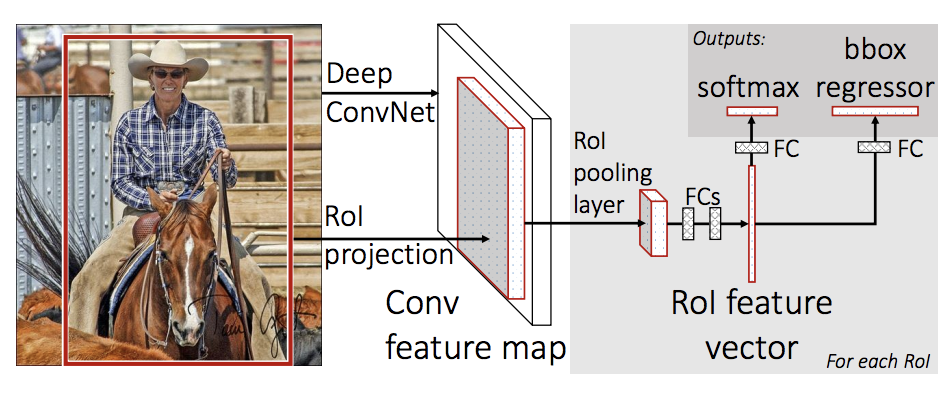

Mask R-CNN adds an extra branch into Faster R-CNN, which also predicts segmentation masks for each instance.

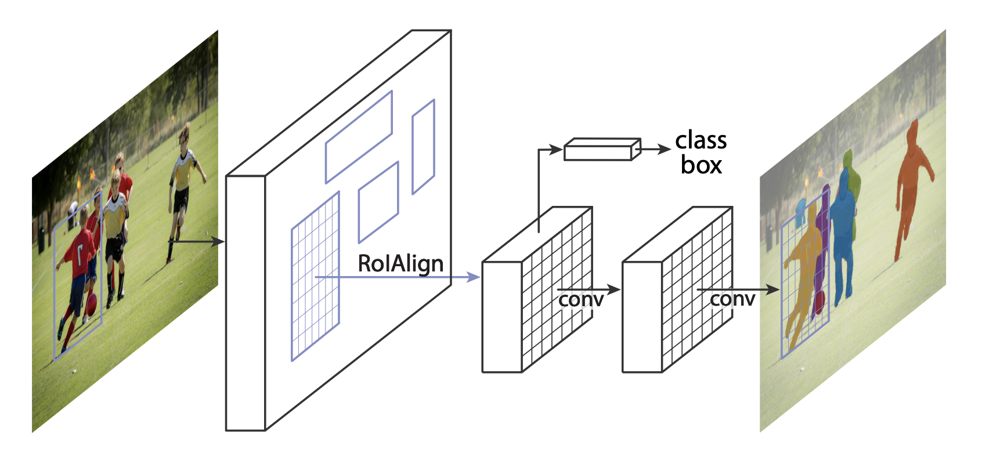

There are two common situations where one might want to modify one of the available models in TorchVision Model Zoo. The first is when we want to start from a pre-trained model, and just finetune the last layer. The other is when we want to replace the backbone of the model with a different one (for faster predictions, for example).

Let’s go see how we would do one or another in the following sections.

### 1 - Finetuning from a pretrained model
Let’s suppose that you want to start from a model pre-trained on COCO and want to finetune it for your particular classes. Here is a possible way of doing it:

In [23]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# load a model pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")

# replace the classifier with a new one, that has
# num_classes which is user-defined
num_classes = 2  # 1 class (solar_panel) + background
# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /Users/sanjaboekle/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [11:02<00:00, 253kB/s]    


### 2 - Modifying the model to add a different backbone

In [ ]:
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator

# load a pre-trained model for classification and return
# only the features
backbone = torchvision.models.mobilenet_v2(weights="DEFAULT").features
# ``FasterRCNN`` needs to know the number of
# output channels in a backbone. For mobilenet_v2, it's 1280
# so we need to add it here
backbone.out_channels = 1280

# let's make the RPN generate 5 x 3 anchors per spatial
# location, with 5 different sizes and 3 different aspect
# ratios. We have a Tuple[Tuple[int]] because each feature
# map could potentially have different sizes and
# aspect ratios
anchor_generator = AnchorGenerator(
    sizes=((32, 64, 128, 256, 512),), aspect_ratios=((0.5, 1.0, 2.0),)
)

# let's define what are the feature maps that we will
# use to perform the region of interest cropping, as well as
# the size of the crop after rescaling.
# if your backbone returns a Tensor, featmap_names is expected to
# be [0]. More generally, the backbone should return an
# ``OrderedDict[Tensor]``, and in ``featmap_names`` you can choose which
# feature maps to use.
roi_pooler = torchvision.ops.MultiScaleRoIAlign(
    featmap_names=["0"], output_size=7, sampling_ratio=2
)

# put the pieces together inside a Faster-RCNN model
model = FasterRCNN(
    backbone,
    num_classes=2,
    rpn_anchor_generator=anchor_generator,
    box_roi_pool=roi_pooler,
)

### Object detection and instance segmentation model for SolarPanelDataset

In our case, we want to finetune from a pre-trained model, given that our dataset is very small, so we will be following approach number 1.

Here we want to also compute the instance segmentation masks, so we will be using Mask R-CNN:

In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor


def get_model_instance_segmentation(num_classes):
    # load an instance segmentation model pre-trained on COCO

    model = torchvision.models.detection.maskrcnn_resnet50_fpn(weights="DEFAULT")

    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(
        in_features_mask, hidden_layer, num_classes
    )

    return model

That’s it, this will make model be ready to be trained and evaluated on your custom dataset.

### Putting everything together

In `references/detection/`, we have a number of helper functions to simplify training and evaluating detection models. Here, we will use `references/detection/engine.py` and `references/detection/utils.py`. Just download everything under `references/detection` to your folder and use them here. On Linux if you have `wget`, you can download them using below commands:

In [25]:
os.system(
    "wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py"
)
os.system(
    "wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py"
)
os.system(
    "wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py"
)
os.system(
    "wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py"
)
os.system(
    "wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py"
)

--2024-01-09 13:41:59--  https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4063 (4,0K) [text/plain]
Saving to: ‘engine.py’

     0K ...                                                   100% 21,4M=0s

2024-01-09 13:42:00 (21,4 MB/s) - ‘engine.py’ saved [4063/4063]

--2024-01-09 13:42:00--  https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8388 (8,2K) [text/plain]
Savin

0

Since v0.15.0 torchvision provides [new Transforms API](https://pytorch.org/vision/stable/transforms.html) to easily write data augmentation pipelines for Object Detection and Segmentation tasks.

Let’s write some helper functions for data augmentation / transformation:

In [26]:
from torchvision.transforms import v2 as T


def get_transform(train):
    transforms = []
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    transforms.append(T.ToDtype(torch.float, scale=True))
    transforms.append(T.ToPureTensor())
    return T.Compose(transforms)

### Testing forward() method (Optional)

Before iterating over the dataset, it’s good to see what the model expects during training and inference time on sample data.

In [62]:
import utils.utils
from utils.dataset import SolarPanelDataset

# Load a pre-trained Faster R-CNN model with a ResNet-50 backbone and Feature Pyramid Network (FPN)
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")

# Create an instance of the SolarPanelDataset class, which represents your dataset
# The get_transform function is used to apply transformations to the images in the dataset
dataset = SolarPanelDataset(f"data/{dataset_name}", get_transform(train=True))

# Create a DataLoader, which is a Python iterable over the dataset
# It shuffles the data and loads it in batches of 2
# The collate_fn argument is a function that decides how to collate the data samples into a batch
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=True, num_workers=4, collate_fn=utils.collate_fn
)

# For Training
# Get the next batch of images and targets from the data loader
images, targets = next(iter(data_loader))

# Convert the batch of images and targets into lists
images = list(image for image in images)
targets = [{k: v for k, v in t.items()} for t in targets]

# Pass the images and targets to the model, which returns the losses and detections
output = model(images, targets)
print(output)

# For inference
# Set the model to evaluation mode
model.eval()

# Create two mock images of size 3x400x400
x = [torch.rand(3, 400, 400), torch.rand(3, 400, 400)]
x

# Pass the mock images to the model, which returns the predictions
predictions = model(x)
predictions[0]

{'loss_classifier': tensor(0.1265, grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.0202, grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0589, grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 'loss_rpn_box_reg': tensor(0.0119, grad_fn=<DivBackward0>)}


{'boxes': tensor([], size=(0, 4), grad_fn=<StackBackward0>),
 'labels': tensor([], dtype=torch.int64),
 'scores': tensor([], grad_fn=<IndexBackward0>)}

Let’s now write the main function which performs the training and the validation:

In [63]:
from utils.engine import train_one_epoch, evaluate
import utils.coco_utils
import utils.coco_eval

# train on the GPU or on the CPU, if a GPU is not available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# our dataset has two classes only - background and person
num_classes = 2
# use our dataset and defined transformations
dataset = SolarPanelDataset(f"data/{dataset_name}", get_transform(train=True))
dataset_test = SolarPanelDataset(f"data/{dataset_name}", get_transform(train=False))

# split the dataset in train and test set
indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices[:-50])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=True, num_workers=4, collate_fn=utils.collate_fn
)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test,
    batch_size=1,
    shuffle=False,
    num_workers=4,
    collate_fn=utils.collate_fn,
)

# get the model using our helper function
model = get_model_instance_segmentation(num_classes)

# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# and a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# let's train it just for 2 epochs
num_epochs = 2

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_test, device=device)

print("That's it!")

Epoch: [0]  [   0/6627]  eta: 16:26:27  lr: 0.000010  loss: 3.5952 (3.5952)  loss_classifier: 1.0108 (1.0108)  loss_box_reg: 0.0622 (0.0622)  loss_mask: 2.4662 (2.4662)  loss_objectness: 0.0472 (0.0472)  loss_rpn_box_reg: 0.0087 (0.0087)  time: 8.9313  data: 4.8767
Epoch: [0]  [  10/6627]  eta: 7:06:42  lr: 0.000060  loss: 2.9419 (2.9249)  loss_classifier: 0.8687 (0.8528)  loss_box_reg: 0.0502 (0.0537)  loss_mask: 1.9398 (1.9529)  loss_objectness: 0.0447 (0.0608)  loss_rpn_box_reg: 0.0043 (0.0047)  time: 3.8692  data: 0.4444
Epoch: [0]  [  20/6627]  eta: 6:39:55  lr: 0.000110  loss: 2.1080 (2.2158)  loss_classifier: 0.5785 (0.6086)  loss_box_reg: 0.0568 (0.0604)  loss_mask: 1.3592 (1.4889)  loss_objectness: 0.0420 (0.0525)  loss_rpn_box_reg: 0.0043 (0.0053)  time: 3.3669  data: 0.0014
Epoch: [0]  [  30/6627]  eta: 6:31:36  lr: 0.000160  loss: 0.9667 (1.7696)  loss_classifier: 0.1691 (0.4492)  loss_box_reg: 0.0633 (0.0658)  loss_mask: 0.7205 (1.1987)  loss_objectness: 0.0401 (0.0507)  l